# Travel in Style, Rain or Shine: Smart Suitcase Packing with Gemini 2.0, Imagen 3, and Open Weather 🧳



> Say goodbye to overpacking and hello to perfectly curated travel wardrobes! This project leverages the power of AI to create personalized packing lists that consider your destination's weather, your personal style, and planned activities, ensuring you're prepared for anything the trip throws your way.



# Setup

In [1]:
import os
import re
import io
import json
import base64
from datetime import datetime, timedelta
from collections import Counter

import google.auth
import requests
from PIL import Image

from google.colab import userdata
from google import genai
from google.genai import types

import vertexai
from vertexai.generative_models import GenerativeModel
from google.cloud import aiplatform_v1beta1

/usr/local/lib/python3.11/dist-packages/pydantic/_internal/_generate_schema.py:502: UserWarning: <built-in function any> is not a Python type (it may be an instance of an object), Pydantic will allow any object with no validation since we cannot even enforce that the input is an instance of the given type. To get rid of this error wrap the type with `pydantic.SkipValidation`.
  warn(


### Environment Variables

In [2]:
PROJECT_ID = "xxxx"
LOCATION = "us-central1"
MODEL_NAME = "gemini-2.0-flash-exp"
IMAGE_MODEL_NAME = "imagen-3.0-generate-002"

# API Keys
GOOGLE_API_KEY=userdata.get('GOOGLE_API_KEY')
WEATHER_API_KEY = "xxxx"

### Authentication

In [3]:
!gcloud auth application-default login
!gcloud auth application-default set-quota-project "xxx"
!gcloud config set project "xxx"

Go to the following link in your browser, and complete the sign-in prompts:

    https://accounts.google.com/o/oauth2/auth?response_type=code&client_id=764086051850-6qr4p6gpi6hn506pt8ejuq83di341hur.apps.googleusercontent.com&redirect_uri=https%3A%2F%2Fsdk.cloud.google.com%2Fapplicationdefaultauthcode.html&scope=openid+https%3A%2F%2Fwww.googleapis.com%2Fauth%2Fuserinfo.email+https%3A%2F%2Fwww.googleapis.com%2Fauth%2Fcloud-platform+https%3A%2F%2Fwww.googleapis.com%2Fauth%2Fsqlservice.login&state=G31AtNuIDUdkPgCXnKUqV35odPyj6Z&prompt=consent&token_usage=remote&access_type=offline&code_challenge=EtBVcNrOZFXxHfFznA7BfqIu3p676li8xql68Npeclc&code_challenge_method=S256

Once finished, enter the verification code provided in your browser: xxx

Credentials saved to file: [/content/.config/application_default_credentials.json]

These credentials will be used by any library that requests Application Default Credentials (ADC).

Quota project "xxx" was added to ADC which can be used by Google client

In [4]:
# Try to load default Google Cloud credentials
# If not available, use a predefined project ID
try:
    credentials, project_id = google.auth.default()
except Exception as e:
    print(f"Error loading credentials: {e}")
    project_id = PROJECT_ID
    credentials = None

In [5]:
# Initialize Vertex AI
try:
    vertexai.init(project=PROJECT_ID, location=LOCATION, credentials=credentials)
    model = GenerativeModel(MODEL_NAME)
    print("Vertex AI initialized successfully.")
except Exception as e:
    print(f"Error initializing Vertex AI: {e}")
    exit()

Vertex AI initialized successfully.


In [6]:
# Define the client
client = genai.Client(api_key=GOOGLE_API_KEY)

# Helper Functions

In [7]:
def get_weather_summary(city, start_date, end_date):
    """
    Fetches and summarizes weather data for a given city and date range.

    Args:
        city (str): Name of the destination city
        start_date (str): Trip start date in YYYY-MM-DD format
        end_date (str): Trip end date in YYYY-MM-DD format

    Returns:
        dict: A dictionary containing summarized weather information with keys:
            - destination: City name
            - country: Country code
            - trip_length: Number of days
            - date_range: Formatted date range string
            - avg_temp: Average temperature in Celsius
            - temp_range: Min-Max temperature range string
            - weather_types: List of common weather conditions

    This function aggregates weather forecast data to provide an overall
    picture of what weather conditions to expect during the trip.
    """
    try:
        # Use OpenWeatherMap's 5-day forecast API (provides data in 3-hour blocks)
        # This is the most cost-effective way to get forecast data for short trips
        url = f"http://api.openweathermap.org/data/2.5/forecast?q={city}&appid={WEATHER_API_KEY}&units=metric"
        response = requests.get(url)
        response.raise_for_status()  # Raise exception for bad responses (4xx, 5xx)
        data = response.json()

        # Parse input dates to datetime objects for comparison
        start = datetime.strptime(start_date, "%Y-%m-%d")
        end = datetime.strptime(end_date, "%Y-%m-%d")
        num_days = (end - start).days + 1

        # Get current weather as a fallback and to retrieve location information
        # This is especially useful for trips far in the future beyond the 5-day forecast
        current_url = f"http://api.openweathermap.org/data/2.5/weather?q={city}&appid={WEATHER_API_KEY}&units=metric"
        current_response = requests.get(current_url)
        current_response.raise_for_status()
        current_data = current_response.json()

        # Lists to collect all temperature readings and weather descriptions
        # We'll use these to calculate the summary statistics
        all_temps = []
        all_descriptions = []

        # Process each forecast entry and collect data that falls within our date range
        for entry in data.get("list", []):
            entry_date = datetime.fromtimestamp(entry["dt"])
            if start <= entry_date <= end:
                all_temps.append(entry["main"]["temp"])
                all_descriptions.append(entry["weather"][0]["description"])

        # If no forecast entries match our date range (e.g., trip is too far in the future)
        # Use current weather as a fallback to provide at least some guidance
        if not all_temps:
            all_temps = [current_data["main"]["temp"]]
            all_descriptions = [current_data["weather"][0]["description"]]

        # Calculate summary statistics from collected temperature data
        min_temp = round(min(all_temps), 1)
        max_temp = round(max(all_temps), 1)
        avg_temp = round(sum(all_temps) / len(all_temps), 1)

        # Find the most common weather types using Counter
        # Limited to top 3 to keep the summary concise
        weather_types = [desc for desc, _ in Counter(all_descriptions).most_common(3)]

        # Build a comprehensive weather summary dictionary
        weather_summary = {
            "destination": data["city"]["name"],
            "country": data["city"]["country"],
            "trip_length": num_days,
            "date_range": f"{start_date} to {end_date}",
            "avg_temp": avg_temp,
            "temp_range": f"{min_temp}°C to {max_temp}°C",
            "weather_types": weather_types
        }

        return weather_summary
    except requests.exceptions.RequestException as e:
        # Handle network errors, API errors, or invalid responses
        print(f"Error fetching weather data: {e}")
        return None

In [8]:
def get_clothing_style_options():
    """
    Returns a list of available clothing style options for the user to choose from.

    Returns:
        list: A list of strings, each representing a different clothing style.

    This function centralizes the style options, making it easier to modify or
    extend the available styles in the future.
    """
    return [
        "Casual",          # Everyday comfortable clothing
        "Business Casual", # Professional but not formal
        "Formal",          # Suits, dress clothes, elegant attire
        "Bohemian",        # Free-spirited, artistic style
        "Streetwear",      # Urban, trendy, often inspired by skate/hip-hop culture
        "Athleisure",      # Athletic wear that's also fashionable for everyday
        "Vintage",         # Retro styles from previous decades
        "Minimalist",      # Simple, clean lines, neutral colors
        "Preppy",          # Clean-cut, collegiate style
        "Edgy/Rock",       # Bold, dark, often inspired by rock music
        "Romantic",        # Soft, feminine details
        "Urban Chic",      # Sophisticated city style
        "Classic",         # Timeless, traditional pieces
        "Traditional/Cultural" # Clothing reflecting specific cultural traditions
    ]

In [9]:
def generate_packing_list(destination, weather_summary, styles, ethnicity, gender, activities, num_days):
    """
    Generates a packing list and outfit suggestions using Gemini AI model.

    Args:
        destination (str): Trip destination
        weather_summary (dict): Weather summary information
        styles (list): List of preferred clothing styles
        ethnicity (str): User's ethnicity for culturally relevant suggestions
        gender (str): User's gender for appropriate clothing suggestions
        activities (list): Planned activities during the trip
        num_days (int): Length of the trip in days

    Returns:
        tuple: (weather_text, packing_list, outfit_descriptions)
            - weather_text: Summary of weather impact on clothing choices
            - packing_list: Complete packing list with recommendations
            - outfit_descriptions: Dictionary of daily outfit suggestions

    This function constructs a detailed prompt for the AI model to generate
    personalized clothing and packing recommendations based on the provided parameters.
    """
    # Format multiple selected styles into a string
    styles_str = " and ".join(styles) if len(styles) <= 2 else ", ".join(styles[:-1]) + ", and " + styles[-1]

    # Format weather information for the prompt
    weather_types_str = ", ".join(weather_summary["weather_types"])

    # Construct a detailed prompt for the AI model
    # This prompt guides the model to produce structured, relevant recommendations
    prompt = f"""
    You are a personal stylist helping someone pack for a {num_days}-day trip to {destination} ({weather_summary["country"]}).
    The traveler identifies as {ethnicity} and is {gender}, preferring a {styles_str} style.

    Weather Summary for the trip:
    - Temperature range: {weather_summary["temp_range"]}
    - Average temperature: {weather_summary["avg_temp"]}°C
    - Weather conditions you might encounter: {weather_types_str}

    Planned activities include: {', '.join(activities)}

    First, provide a brief 2-3 sentence summary of the overall weather conditions expected during the trip and how this will affect clothing choices.

    Then, suggest a complete packing list with versatile clothing items that can be mixed and matched,
    considering the weather variations, cultural aspects, and planned activities.

    Create {num_days} unique outfits, one for each day of the trip.
    For each outfit, consider the weather conditions and activities.

    Provide outfit descriptions in the following structured format:
    1. OUTFIT_DESCRIPTION_1: [Description of Day 1 Outfit]
    2. OUTFIT_DESCRIPTION_2: [Description of Day 2 Outfit]
    ...and so on.

    Include accessories and any cultural elements if appropriate.
    If you are unable to make any suggestion due to any reason, answer with the string "NO_OUTFITS".
    """

    try:
        # Generate content using the Gemini model
        response = model.generate_content(prompt)
        packing_list = response.text

        # Clean up the response by removing asterisks that might be used for formatting
        packing_list = re.sub(r"[*]", "", packing_list)

        # Check if the model was unable to generate suggestions
        if "NO_OUTFITS" in packing_list:
            return packing_list, {}

        # Extract the weather summary section from the response
        # This looks for the text before the first double newline or specific section headers
        weather_summary_text = ""
        summary_match = re.search(r".*?(?=(\n\n|Packing List|OUTFIT_DESCRIPTION_1))", packing_list, re.DOTALL)
        if summary_match:
            weather_summary_text = summary_match.group(0).strip()

        # Extract individual outfit descriptions using regex
        # The model was instructed to format these in a specific way that we can parse
        outfit_descriptions = {}
        for i in range(1, num_days + 1):
            match = re.search(f"OUTFIT_DESCRIPTION_{i}: (.*)", packing_list)
            if match:
                outfit_descriptions[f"day {i} outfit"] = match.group(1).strip()
            else:
                print(f"Warning: No match for OUTFIT_DESCRIPTION_{i}")
                outfit_descriptions[f"day {i} outfit"] = None

        return weather_summary_text, packing_list, outfit_descriptions
    except Exception as e:
        # Handle any errors in the content generation process
        print(f"Error generating content from Gemini: {e}")
        return None, None, None

In [10]:
def process_generated_image(image_bytes):
    """
    Process raw image bytes from the generation API and convert to a PIL Image object.

    Args:
        image_bytes (bytes): Raw bytes of the generated image

    Returns:
        PIL.Image: Processed image object that can be manipulated with PIL

    This is a helper function to convert the raw image bytes into a format that
    can be used for display or further processing (like creating collages).
    """
    try:
        # Create BytesIO object from raw bytes
        image_buffer = io.BytesIO(image_bytes)
        # Ensure we're at the start of the buffer
        image_buffer.seek(0)
        # Open with PIL
        image = Image.open(image_buffer)
        return image
    except Exception as e:
        # Handle any errors in image processing
        print(f"Error processing image details: {e}")
        # Print the first few bytes for debugging purposes
        print(f"First few bytes: {image_bytes[:20] if image_bytes else 'No bytes'}")
        return None

In [11]:
def generate_image_from_outfit(destination, weather_types, temp_range, gender, ethnicity, styles, outfit_description, item_name):
    """
    Generates a realistic fashion image based on outfit description and contextual details.

    Args:
        destination (str): Trip destination
        weather_types (list): List of weather conditions
        temp_range (str): Temperature range for the trip
        gender (str): User's gender
        ethnicity (str): User's ethnicity
        styles (list): List of preferred styles
        outfit_description (str): Text description of the outfit
        item_name (str): Identifier for the outfit (e.g., "day 1 outfit")

    Returns:
        object: Response from the image generation API containing generated images

    This function creates a detailed prompt for the image generation model that
    incorporates all the contextual elements to produce a realistic visualization
    of the suggested outfit.
    """
    # Check if we have a valid outfit description
    if not outfit_description:
        print(f"No outfit description found for {item_name}, skipping image generation.")
        return None

    # Format the style preference string
    styles_str = " and ".join(styles) if len(styles) <= 2 else ", ".join(styles[:-1]) + ", and " + styles[-1]

    # Join the weather conditions into a readable string
    weather_conditions = ", ".join(weather_types)

    # Create a detailed prompt for the image generation model
    # This prompt includes all contextual elements to create a personalized image
    image_prompt = f"""
    Generate a realistic fashion photograph of a {gender} of {ethnicity} ethnicity wearing {outfit_description}.
    They are traveling to {destination} where the weather conditions include {weather_conditions}
    with temperatures ranging from {temp_range}.
    The outfit should reflect a {styles_str} style and be appropriate for these weather conditions.
    """

    try:
        # Configure image generation parameters
        sampleCount = 4  # Generate 4 different versions of the outfit
        safetySetting = "BLOCK_MEDIUM_AND_ABOVE"  # Content safety setting
        personGeneration = "ALLOW_ADULT"  # Allow generating images of adults
        aspectRatio = "1:1"  # Square aspect ratio for the image

        # Call the image generation API
        result = client.models.generate_images(
          model=IMAGE_MODEL_NAME,
          prompt=image_prompt,
          config=types.GenerateImagesConfig(
              number_of_images=sampleCount,
              output_mime_type="image/jpeg",
              person_generation=personGeneration,
              aspect_ratio=aspectRatio
          )
        )

        return result
    except Exception as e:
        # Handle any errors in the image generation process
        print(f"Error generating image: {e}")
        return None

In [12]:
def create_image_collage(images):
    """
    Creates a collage from multiple generated outfit images.

    Args:
        images (list): List of PIL.Image objects

    Returns:
        PIL.Image: A single collage image combining all input images

    This function arranges multiple outfit images into a grid layout to create
    a visual wardrobe overview for the trip.
    """
    if not images:
        return None

    # Calculate grid dimensions based on number of images
    # This aims to create a roughly square grid
    num_images = len(images)
    num_cols = int(num_images**0.5)  # Square root for balanced grid
    num_rows = (num_images + num_cols - 1) // num_cols  # Ceiling division

    # Calculate dimensions for the individual images and the collage
    # Resize original images to half size to make the collage more manageable
    img_width, img_height = images[0].size
    img_width //= 2
    img_height //= 2

    # Calculate total collage dimensions
    collage_width = num_cols * img_width
    collage_height = num_rows * img_height

    # Create a new blank image for the collage
    collage = Image.new('RGB', (collage_width, collage_height))

    # Track position for pasting images
    x_offset = 0
    y_offset = 0

    # Place each image in the grid
    for i, img in enumerate(images):
        # Resize the image to fit in the grid
        resized_img = img.resize((img_width, img_height))
        # Paste the image at the current position
        collage.paste(resized_img, (x_offset, y_offset))
        # Update horizontal position
        x_offset += img_width

        # Move to the next row if we've filled the current row
        if (i + 1) % num_cols == 0:
            y_offset += img_height
            x_offset = 0

    return collage

# Driver / Main Function

In [13]:
def main():
    """
    Main function that coordinates the entire travel wardrobe planning process.

    This function:
    1. Collects user input about their trip and preferences
    2. Fetches weather data for the destination
    3. Generates personalized packing lists and outfit suggestions
    4. Creates visualizations of the suggested outfits
    5. Displays and saves the results

    The function handles the entire workflow from user input to final output.
    """
    # Get basic trip information
    destination = input("Enter your destination city: ")

    # Get travel dates
    start_date = input("Enter your travel start date (YYYY-MM-DD): ")
    end_date = input("Enter your travel end date (YYYY-MM-DD): ")

    # Calculate number of days for the trip
    try:
        # Parse the dates to validate format and calculate trip duration
        start = datetime.strptime(start_date, "%Y-%m-%d")
        end = datetime.strptime(end_date, "%Y-%m-%d")
        num_days = (end - start).days + 1
        print(f"Planning for a {num_days}-day trip")
    except ValueError:
        # Handle invalid date formats
        print("Invalid date format. Please use YYYY-MM-DD.")
        return

    # Display available style options and allow multiple selections
    print("\nAvailable clothing styles:")
    style_options = get_clothing_style_options()
    for i, style in enumerate(style_options, 1):
        print(f"{i}. {style}")

    # Allow selecting multiple styles with comma-separated input
    style_input = input("Enter your preferred style(s) - separate multiple styles with commas (e.g., 1,4,7): ")
    selected_styles = []

    # Process the style selection input
    try:
        # Split the input by commas and process each selection
        style_indices = [int(idx.strip()) for idx in style_input.split(",")]
        for idx in style_indices:
            if 1 <= idx <= len(style_options):
                selected_styles.append(style_options[idx-1])
    except ValueError:
        # If input can't be parsed as numbers, assume it's direct style names
        selected_styles = [style.strip() for style in style_input.split(",")]

    # Fallback to "Casual" if no valid styles were selected
    if not selected_styles:
        print("No valid styles selected. Defaulting to Casual style.")
        selected_styles = ["Casual"]
    else:
        print(f"Selected styles: {', '.join(selected_styles)}")

    # Get user's gender and ethnicity for personalized recommendations
    gender = input("Choose your gender (male, female, or other): ")
    ethnicity = input("Enter your ethnicity (e.g., Asian, Black, Caucasian, Hispanic, Middle Eastern, etc.): ")

    # Get planned activities for the trip
    print("\nWhat activities are you planning during your trip? (comma-separated list)")
    print("Examples: Sightseeing, Business meetings, Beach, Hiking, Dining out, Formal events")
    activities_input = input("Activities: ")
    activities = [act.strip() for act in activities_input.split(",")]

    # Get summarized weather forecast for the trip
    weather_summary = get_weather_summary(destination, start_date, end_date)

    # Process results if weather data was successfully retrieved
    if weather_summary:
        # Display the weather summary information
        print("\nWeather Summary for your trip:")
        print(f"Destination: {weather_summary['destination']}, {weather_summary['country']}")
        print(f"Date Range: {weather_summary['date_range']} ({weather_summary['trip_length']} days)")
        print(f"Temperature Range: {weather_summary['temp_range']}")
        print(f"Average Temperature: {weather_summary['avg_temp']}°C")
        print(f"Weather Conditions: {', '.join(weather_summary['weather_types'])}")

        # Generate packing list with the summarized weather data and user preferences
        weather_text, packing_list, outfit_descriptions = generate_packing_list(
            destination, weather_summary, selected_styles, ethnicity, gender, activities, num_days
        )

        if packing_list:
            # Display the weather impact analysis
            print("\nWeather Impact Analysis:")
            print(weather_text)

            # Display the complete packing list
            print("\nPacking List and Outfit Suggestions:")
            print(packing_list)

            if outfit_descriptions:
                # Display each day's outfit suggestion
                print("\nOutfit Descriptions:")
                for day, description in outfit_descriptions.items():
                    print(f"{day}: {description}")

                # Collect generated images for each outfit
                images = []

                # Generate images for each outfit using the summarized weather information
                for item_name, outfit_description in outfit_descriptions.items():
                    generated_images_from_outfits = generate_image_from_outfit(
                        destination, weather_summary['weather_types'],
                        weather_summary['temp_range'], gender, ethnicity,
                        selected_styles, outfit_description, item_name
                    )

                    # Process each generated image
                    if generated_images_from_outfits:
                        for img_result in generated_images_from_outfits.generated_images:
                            processed_image = process_generated_image(img_result.image.image_bytes)
                            if processed_image:
                                images.append(processed_image)

                # Create and save a collage of all the generated outfit images
                if images:
                    collage = create_image_collage(images)
                    if collage:
                        collage.save("travel_outfit_collage.png")
                        print("Outfit collage saved to travel_outfit_collage.png")
                        try:
                            # Display the collage if in an IPython environment (Jupyter/Colab)
                            from IPython.display import Image, display
                            display(Image('travel_outfit_collage.png'))
                        except ImportError:
                            print("IPython not available. Image saved to file system.")
                else:
                    print("No images to create a collage.")
            else:
                print("No outfit descriptions to generate images from.")
        else:
            print("Could not generate packing list. Please check the settings.")
    else:
        print("Could not retrieve weather forecast. Please check your destination and API key.")

# Entry point of the application

Enter your destination city: Mexico City
Enter your travel start date (YYYY-MM-DD): 2025-03-01
Enter your travel end date (YYYY-MM-DD): 2025-03-10
Planning for a 10-day trip

Available clothing styles:
1. Casual
2. Business Casual
3. Formal
4. Bohemian
5. Streetwear
6. Athleisure
7. Vintage
8. Minimalist
9. Preppy
10. Edgy/Rock
11. Romantic
12. Urban Chic
13. Classic
14. Traditional/Cultural
Enter your preferred style(s) - separate multiple styles with commas (e.g., 1,4,7): 1, 4, 6, 12
Selected styles: Casual, Bohemian, Athleisure, Urban Chic
Choose your gender (male, female, or other): Female
Enter your ethnicity (e.g., Asian, Black, Caucasian, Hispanic, Middle Eastern, etc.): Asian

What activities are you planning during your trip? (comma-separated list)
Examples: Sightseeing, Business meetings, Beach, Hiking, Dining out, Formal events
Activities: Sightseeing, Dining Out

Weather Summary for your trip:
Destination: Mexico City, MX
Date Range: 2025-03-01 to 2025-03-10 (10 days)
Tempe

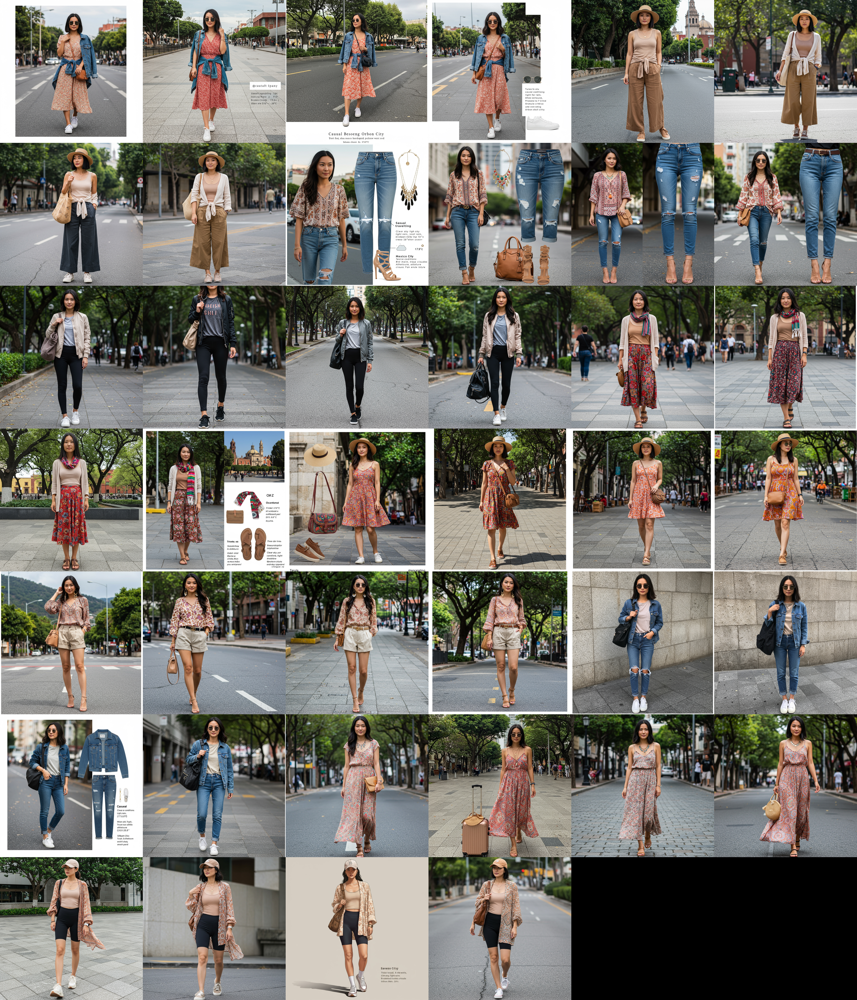

In [14]:
if __name__ == "__main__":
    main()